In [2]:
%matplotlib ipympl

In [1]:
import sys
import os
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
from shapely.geometry import shape,box
import pickle
sys.path.append('..')
import pyproj
import pickle
import seaborn as sns

In [2]:
from dggrid4py import DGGRIDv7, Dggs, dgselect, dggs_types

In [3]:
from h3_helper import *
from s2_helper import *
from eaggr_helper import *
from rhealpix_helper import *

# CORINE VECTOR

#### get areas for all CORINE classes in given extent (Tartu area) 

In [18]:
vector = os.path.dirname(os.getcwd()) + r'/data/eesti_clipped/land_cover/CorineEestiWGS84.gpkg'

In [22]:
corine_legend = pd.read_pickle(os.path.dirname(os.getcwd()) + r'/data/eesti_clipped/land_cover/corine_legend.pkl')

In [23]:
corine_legend['CLC_CODE'] = corine_legend['CLC_CODE'].astype('str')

In [24]:
corine_original = gpd.read_file(vector)
corine_original['code_18'] = corine_original['code_18'].astype('str')
corine_original.crs = 'EPSG:4326'

In [25]:
corine_original = corine_original.merge(corine_legend[['CLC_CODE','LABEL3']], left_on='code_18', right_on='CLC_CODE')

In [26]:
corine_clipped = gpd.clip(corine_original,box(26.521263, 58.283163, 26.900083, 58.505180))

In [27]:
corine_clipped = corine_clipped.to_crs('EPSG:3301')

In [28]:
corine_clipped['area_original_from_geom'] = corine_clipped['geometry'].area/10000

In [29]:
corine_clipped_group = corine_clipped.groupby('code_18',as_index=False)['area_original_from_geom'].sum().reset_index(drop=True)

### H3

#### Injest corine vector at resolution 11, consequently downsample to resolution 7

In [40]:
h3_cor_11 = vector_to_h3(vector,'code_18',11,[26.521263, 58.283163, 26.900083, 58.505180])
h3_cor_11 = create_h3_geometry(h3_cor_11)

Start filling raster extent with h3 indexes at resolution 11


In [41]:
h3_cor_11 = h3_cor_11.to_crs('EPSG:3301')
h3_cor_11['area_h3_from_geom'] = h3_cor_11['geometry'].area/10000

In [42]:
h3_cor_10 = cell_h3_downsampling(h3_cor_11,'cell_id','code_18',10,'categorical')
h3_cor_10 = create_h3_geometry(h3_cor_10)

In [43]:
h3_cor_10 = h3_cor_10.to_crs('EPSG:3301')
h3_cor_10['area_h3_from_geom'] = h3_cor_10['geometry'].area/10000

In [44]:
h3_cor_9 = cell_h3_downsampling(h3_cor_11,'cell_id','code_18',9,'categorical')
h3_cor_9 = create_h3_geometry(h3_cor_9)

In [45]:
h3_cor_9 = h3_cor_9.to_crs('EPSG:3301')
h3_cor_9['area_h3_from_geom'] = h3_cor_9['geometry'].area/10000

In [46]:
h3_cor_8 = cell_h3_downsampling(h3_cor_11,'cell_id','code_18',8,'categorical')
h3_cor_8 = create_h3_geometry(h3_cor_8)

In [47]:
h3_cor_8 = h3_cor_8.to_crs('EPSG:3301')
h3_cor_8['area_h3_from_geom'] = h3_cor_8['geometry'].area/10000

In [48]:
h3_cor_7 = cell_h3_downsampling(h3_cor_11,'cell_id','code_18',7,'categorical')
h3_cor_7 = create_h3_geometry(h3_cor_7)

In [49]:
h3_cor_7 = h3_cor_7.to_crs('EPSG:3301')
h3_cor_7['area_h3_from_geom'] = h3_cor_7['geometry'].area/10000

#### Calculate areal differences

In [115]:
def calculate_vector_diff_df(dfs,init,classes,dggs):
    result = []
    for n,df in enumerate(dfs):
        df_grouped = df.groupby(classes)['cell_id'].count().reset_index().rename(columns={'cell_id':'cells_cnt'})
        df_grouped[f'area_{dggs}'] = (df_grouped['cells_cnt']*df['geometry'][0].area)/10000
        res = pd.merge(df_grouped,init,how='right')
        res[f'area_{dggs}'].fillna(0,inplace=True)
        res['cells_cnt'].fillna(0,inplace=True)
        res[f'difference_{dggs}'] = abs(((res[f'area_{dggs}'] - res['area_original_from_geom'])/res['area_original_from_geom'])*100)
        res['res'] = n+1
        result.append(res)
    return pd.concat(result)

In [116]:
h3_cor = calculate_vector_diff_df([h3_cor_11,h3_cor_10,h3_cor_9,h3_cor_8,h3_cor_7],corine_clipped_group,'code_18','h3')

In [114]:
h3_cor.groupby('res').agg(diff=('difference_h3','mean'))

,diff
res,
1,0.477668
2,22.267042
3,63.062856
4,179.498168
5,472.690729


### s2

In [ ]:
#### Injest corine vector at resolution 11, consequently downsample to resolution 13

In [52]:
s2_cor_18 = vector_to_s2(vector,'code_18',18,[26.521263, 58.283163, 26.900083, 58.505180])
s2_cor_18 = create_s2_geometry(s2_cor_18)
s2_cor_18 = s2_cor_18.to_crs('EPSG:3301')
s2_cor_18['area_s2_from_geom'] = s2_cor_18['geometry'].area/10000

Start filling raster extent with s2 indexes at resolution 18


In [53]:
s2_cor_17 = cell_s2_downsampling(s2_cor_18,'cell_id','code_18',17,'categorical')
s2_cor_17 = create_s2_geometry(s2_cor_17)
s2_cor_17 = s2_cor_17.to_crs('EPSG:3301')
s2_cor_17['area_s2_from_geom'] = s2_cor_17['geometry'].area/10000

In [54]:
s2_cor_16 = cell_s2_downsampling(s2_cor_18,'cell_id','code_18',16,'categorical')
s2_cor_16 = create_s2_geometry(s2_cor_16)
s2_cor_16 = s2_cor_16.to_crs('EPSG:3301')
s2_cor_16['area_s2_from_geom'] = s2_cor_16['geometry'].area/10000

In [55]:
s2_cor_15 = cell_s2_downsampling(s2_cor_18,'cell_id','code_18',15,'categorical')
s2_cor_15 = create_s2_geometry(s2_cor_15)
s2_cor_15 = s2_cor_15.to_crs('EPSG:3301')
s2_cor_15['area_s2_from_geom'] = s2_cor_15['geometry'].area/10000

In [56]:
s2_cor_14 = cell_s2_downsampling(s2_cor_18,'cell_id','code_18',14,'categorical')
s2_cor_14 = create_s2_geometry(s2_cor_14)
s2_cor_14 = s2_cor_14.to_crs('EPSG:3301')
s2_cor_14['area_s2_from_geom'] = s2_cor_14['geometry'].area/10000

In [117]:
s2_cor = calculate_vector_diff_df([s2_cor_18,s2_cor_17,s2_cor_16,s2_cor_15,s2_cor_14],corine_clipped_group,'code_18','s2')

In [133]:
s2_cor.groupby('res').agg(diff=('difference_s2','mean'))

,diff
res,
1,0.547985
2,12.246139
3,34.759599
4,65.757652
5,116.353198


### rHEALPIx 

In [58]:
def vector_to_rhealpix(res,extent,vector,column):
    dfs = []
    for r in res:
        if len(dfs)==0:        
            df = get_rhpix_cells(r,extent)
            df = create_rhpix_geometry(df)
            df = df.to_crs(vector.crs)
            df['poly_geom'] = df['geometry']
            df['geometry'] = df['geometry'].centroid
            df = gpd.sjoin(df, vector).reset_index(drop=True)
            init_inject = df[['geometry',column]].copy()
            df['geometry'] = df['poly_geom']
        else:
            df = get_rhpix_cells(r,extent)
            df = create_rhpix_geometry(df)
            df = df.to_crs(vector.crs)
            df = gpd.sjoin(df, init_inject).reset_index()
            
            df = df.groupby(['index', column]).agg(count=(column, 'count'),geometry=('geometry','first')).reset_index().sort_values(
            by=['index', column, 'count']).groupby('index', as_index=False, sort=False).first().rename(columns={'index':'cell_id'})
            
        dfs.append(gpd.GeoDataFrame(df[['cell_id','geometry',column]]))
    
    return dfs

In [133]:
dfs_rh = vector_to_rhealpix([11,10,9,8,7],[26.521263, 58.283163, 26.900083, 58.505180],corine_clipped,'code_18')

In [134]:
rheal_cor = calculate_vector_diff_df(dfs_rh,corine_clipped_group,'code_18','rpix')

In [164]:
rheal_cor.groupby('res').agg(diff=('difference_rpix','std'))

,diff
res,
1,0.511310
2,26.800605
3,81.248503
4,295.848596
5,1406.518479


## DGGRID

In [46]:
def vector_to_DGGRID(res,extent,vector,column,dggrid,dggrid_dggs):
    dfs = []
    extent = shape(box(extent[0],extent[1],extent[2],extent[3]))
    
    for r in res:
        if len(dfs)==0:        
            df = dggrid.grid_cell_polygons_for_extent(dggrid_dggs, r, clip_geom=extent)
            df = df.to_crs(vector.crs)
            df = df.rename(columns={'Name':'cell_id'})
            df['poly_geom'] = df['geometry']
            df['geometry'] = df['geometry'].centroid
            df = gpd.sjoin(df, vector).reset_index(drop=True)
            init_inject = df[['geometry',column]].copy()
            df['geometry'] = df['poly_geom']
        else:
            df = dggrid.grid_cell_polygons_for_extent(dggrid_dggs, r, clip_geom=extent).rename(columns={'name':'cell_id'})
            df = df.to_crs(vector.crs)
            df = df.rename(columns={'Name':'cell_id'})
            df = gpd.sjoin(df, init_inject).reset_index()
            df = df.groupby(['index', column]).agg(count=(column, 'count'),geometry=('geometry','first')).reset_index().sort_values(
            by=['index', column, 'count']).groupby('index', as_index=False, sort=False).first().rename(columns={'index':'cell_id'})
            
        dfs.append(gpd.GeoDataFrame(df[['cell_id','geometry',column]]))
    
    return dfs

In [20]:
dggrid = DGGRIDv7(executable='/mnt/d/UTCloud/DGGS/working/Python/PyProj/cell_stats/dggrid', 
                  working_dir='/mnt/d/UTCloud/DGGS/working/Python/PyProj/cell_stats/dggrid_workdir', capture_logs=False, silent=False)

In [ ]:
dfs_3H = vector_to_DGGRID([21,20,19,18,17],[26.521263, 58.283163, 26.900083, 58.505180],corine_clipped,'code_18',dggrid,'ISEA3H')

In [64]:
dfs_4T = vector_to_DGGRID([16,15,14,13,12],[26.521263, 58.283163, 26.900083, 58.505180],corine_clipped,'code_18',dggrid,'ISEA4T')

** executing DGGRID version 7.07 **
type sizes: big int: 64 bits / big double: 128 bits

** loading meta file metafile_051b02a8-00ce-4556-9af2-f84fe3d7fa76...
* using parameter values:
dggrid_operation GENERATE_GRID (user set)
dggs_type ISEA4T (user set)
dggs_topology TRIANGLE (user set)
dggs_proj ISEA (user set)
dggs_aperture_type PURE (user set)
dggs_aperture 4 (user set)
proj_datum WGS84_AUTHALIC_SPHERE (default)
dggs_orient_specify_type SPECIFIED (user set)
dggs_num_placements 1 (user set)
dggs_orient_output_file_name grid.meta (default)
dggs_vert0_lon 11.25 (user set)
dggs_vert0_lat 58.2825 (user set)
dggs_vert0_azimuth 0 (user set)
dggs_res_specify_type SPECIFIED (user set)
dggs_res_spec 16 (user set)
rng_type RAND (default)
geodetic_densify 0 (default)
clip_subset_type GDAL (user set)
clip_region_files /mnt/d/UTCloud/DGGS/working/Python/PyProj/cell_stats/dggrid_workdir/temp_clip_d9415ae0-0825-411e-af31-da7e85494ef8.geojson (user set)
clip_type POLY_INTERSECT (default)
clipper_sc

In [121]:
isea3H_cor = calculate_vector_diff_df(dfs_3H,corine_clipped_group,'code_18','ISEA3H')

In [120]:
isea4T_cor = calculate_vector_diff_df(dfs_4T,corine_clipped_group,'code_18','ISEA4T')

## Compare results

In [135]:
corine_results = pd.concat([h3_cor,s2_cor,rheal_cor,isea3H_cor,isea4T_cor],axis=1)

In [138]:
corine_results.to_csv(r'd:\UTCloud\DGGS\results\downsampling_loss\corine.csv')

In [3]:
corine_results = pd.read_csv(r'd:\UTCloud\DGGS\results\downsampling_loss\corine.csv')

In [136]:
corine_results = corine_results.loc[:,~corine_results.columns.duplicated()]

In [7]:
corine_results_grouped = corine_results.groupby('res').mean()[['difference_h3','difference_s2','difference_rpix','difference_ISEA3H','difference_ISEA4T']].reset_index()

In [10]:
corine_results_grouped

,res,difference_h3,difference_s2,difference_rpix,difference_ISEA3H,difference_ISEA4T
0,1,0.379703,0.678108,0.518847,0.380775,0.902225
1,2,16.714696,9.404408,20.439800,14.030731,20.508349
2,3,55.365011,27.376026,69.156958,32.537896,51.908402
3,4,132.704048,56.791683,167.821866,65.010018,93.321190
4,5,233.275153,93.422392,339.694724,103.562838,202.118576


In [19]:
corine_results_grouped.columns = ['resolution','H3','S2','rHEALPix','ISEA3H','EAGGR']

In [30]:
fig, ax = plt.subplots(figsize=(10,5))
sns.lineplot(data=corine_results_grouped.set_index('resolution'),ax=ax)
ax.tick_params(axis='both', which='major', labelsize=12)
ax.set_xlabel('Resolution', fontsize=12)
ax.set_ylabel('Mean difference from initial area, %', fontsize=12)
ax.set_xticks(corine_results_grouped['resolution'])
plt.tight_layout()
plt.savefig(r'd:\UTCloud\DGGS\results\downsampling_loss\vector.png', bbox_inches="tight",dpi=300)

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [7]:
corine_results[corine_results['res']==1]

,Unnamed: 0,code_18,cells_cnt,area_h3,area_original_from_geom,difference_h3,res,area_s2,difference_s2,area_rpix,difference_rpix,area_ISEA3H,difference_ISEA3H,area_ISEA4T,difference_ISEA4T
0,0,111,302.0,51.929626,51.456504,0.919460,1,52.053717,1.160618,51.410316,0.089761,51.463827,0.014231,53.120286,3.233377
1,1,112,19030.0,3272.254216,3281.158992,0.271391,1,3292.469506,0.344711,3294.276644,0.399787,3278.490823,0.081318,3288.682896,0.229306
2,2,121,7124.0,1224.988914,1226.108209,0.091288,1,1230.020708,0.319099,1237.221382,0.906378,1224.348942,0.143484,1218.185443,0.646172
3,3,122,1271.0,218.551503,218.260755,0.133212,1,220.437426,0.997280,217.690556,0.261246,216.148072,0.967963,224.418288,2.821182
4,4,124,3251.0,559.017260,562.064793,0.542203,1,563.963200,0.337756,563.906902,0.327740,561.200776,0.153722,566.417435,0.774402
5,5,131,257.0,44.191767,43.704139,1.115750,1,43.713619,0.021692,44.341397,1.458120,44.111851,0.932893,42.973715,1.671292
6,6,133,507.0,87.179868,86.518288,0.764671,1,87.427238,1.050587,86.594251,0.087800,85.773044,0.861371,84.156858,2.729399
7,7,141,683.0,117.443491,117.679572,0.200614,1,117.480351,0.169292,118.404384,0.615919,118.121735,0.375735,118.774573,0.930493
8,8,142,616.0,105.922680,106.537227,0.576838,1,106.983330,0.418730,105.712462,0.774156,105.868443,0.627746,106.837430,0.281783
9,9,211,104695.0,18002.556762,18041.234621,0.214386,1,18150.929850,0.608025,18134.024964,0.514324,18034.395251,0.037910,18044.782214,0.019664


# MERIT_dem Raster

In [4]:
import rasterio
from rasterio.warp import calculate_default_transform, reproject, Resampling
from rasterio.plot import show, show_hist
import pysal.viz.mapclassify as mc

In [5]:
raster = rasterio.open(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m.tif")

### Clip raster to area of interset

In [24]:
from rasterio.mask import mask
import math

In [144]:
out_image, out_transform = mask(dataset=raster, shapes=[box(26.521263, 58.283163, 26.900083, 58.505180)], crop=True)

In [260]:
out_meta = raster.meta.copy()

In [261]:
out_meta.update({"driver": "GTiff","height": out_image.shape[1],"width": out_image.shape[2],"transform": out_transform})

In [262]:
with rasterio.open(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m_clipped.tif", "w", **out_meta) as dest:
    dest.write(out_image)

In [5]:
clipped_raster = rasterio.open(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m_clipped.tif")

In [266]:
fig, ax = plt.subplots(figsize=(7,7))
show(clipped_raster,ax=ax)
plt.tight_layout()
plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

#### Reproject raster to Estonian crs in order to calculate areas

In [268]:
dst_crs = 'EPSG:3301'

In [269]:
with rasterio.open(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m_clipped.tif") as src:
    transform, width, height = calculate_default_transform(src.crs, dst_crs, src.width, src.height, *src.bounds)
    kwargs = src.meta.copy()
    kwargs.update({'crs': dst_crs,'transform': transform,'width': width,'height': height})
    with rasterio.open(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m_clipped_3301.tif", 'w', **kwargs) as dst:
        for i in range(1, src.count + 1):
            reproject(source=rasterio.band(src, i),
                      destination=rasterio.band(dst, i),
                      src_transform=src.transform,
                      src_crs=src.crs,
                      dst_transform=transform,
                      dst_crs=dst_crs,
                      resampling=Resampling.nearest)

In [21]:
proj_raster = rasterio.open(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m_clipped_3301.tif")

In [195]:
fig, ax = plt.subplots(figsize=(7,7))
show_hist(proj_raster, bins=10, lw=0.0, stacked=False, alpha=0.3,ax=ax)
plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [273]:
fig, ax = plt.subplots(figsize=(7,7))
show(proj_raster,ax=ax)
plt.tight_layout()
plt.show()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [22]:
# filter out weird values
clipped_raster_arr_filtered = proj_raster.read(1)[proj_raster.read(1)<3.4028235e+37]

In [27]:
# get classification
intervals = mc.EqualInterval(clipped_raster_arr_filtered,10)

In [28]:
# Get areas of evvery class in hectars from raster pixel size
original_areas = intervals.counts*abs(proj_raster.transform[0]*proj_raster.transform[4])/10000

In [29]:
raster_areas = pd.DataFrame({'intervals':intervals.get_legend_classes(),'area_original_from_raster':original_areas})
raster_areas['classes']= raster_areas.index

### H3

#### Injest raster at resolution 11, consequently downsample to resolution 7

In [13]:
h3_el_11 = raster_to_h3(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m.tif", 'elevation', 8, 12, [26.521263, 58.283163, 26.900083, 58.505180], 3)
h3_el_11 = create_h3_geometry(h3_el_11)

Raster pixel size 92.6624388709314
11
Start filling raster extent with h3 indexes at resolution 11
Start getting raster values for hexes at resolution 11


In [7]:
h3_el_11['geometry'] = h3_el_11['geometry'].centroid

C:\Users\Iam\Anaconda3\envs\dggs\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  """Entry point for launching an IPython kernel.


In [10]:
h3_el_11

,cell_id,elevation,geometry
0,8b1136b410e1fff,35.237854,POINT (26.56230 58.40911)
1,8b1136a2e488fff,72.525620,POINT (26.64446 58.29314)
2,8b1136a56191fff,39.694290,POINT (26.79118 58.32380)
3,8b1134696c43fff,35.318192,POINT (26.65404 58.44611)
4,8b1136a0b503fff,62.211246,POINT (26.77546 58.30049)
...,...,...,...
317851,8b1136a6c316fff,75.934006,POINT (26.73527 58.45589)
317852,8b1136a65c94fff,35.829121,POINT (26.67239 58.42240)
317853,8b1136a523a9fff,32.903709,POINT (26.83478 58.33303)
317854,8b1136a25adefff,74.488655,POINT (26.57105 58.30670)


In [12]:
h3_el_11.to_file(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/h3_11.geojson", driver='GeoJSON')

In [6]:
h3_el_11 = h3_el_11.to_crs('EPSG:3301')
h3_el_11['area_h3_from_geom'] = h3_el_11['geometry'].area/10000

In [14]:
h3_el_10 = cell_h3_downsampling(h3_el_11,'cell_id','elevation',10,'numeric')
h3_el_10 = create_h3_geometry(h3_el_10)

In [15]:
h3_el_10.to_file(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/h3_10.geojson", driver='GeoJSON')

In [8]:
h3_el_10 = h3_el_10.to_crs('EPSG:3301')
h3_el_10['area_h3_from_geom'] = h3_el_10['geometry'].area/10000

In [9]:
h3_el_9 = cell_h3_downsampling(h3_el_11,'cell_id','elevation',9,'numeric')
h3_el_9 = create_h3_geometry(h3_el_9)

In [10]:
h3_el_9 = h3_el_9.to_crs('EPSG:3301')
h3_el_9['area_h3_from_geom'] = h3_el_9['geometry'].area/10000

In [11]:
h3_el_8 = cell_h3_downsampling(h3_el_11,'cell_id','elevation',8,'numeric')
h3_el_8 = create_h3_geometry(h3_el_8)

In [12]:
h3_el_8 = h3_el_8.to_crs('EPSG:3301')
h3_el_8['area_h3_from_geom'] = h3_el_8['geometry'].area/10000

In [13]:
h3_el_7 = cell_h3_downsampling(h3_el_11,'cell_id','elevation',7,'numeric')
h3_el_7 = create_h3_geometry(h3_el_7)

In [14]:
h3_el_7 = h3_el_7.to_crs('EPSG:3301')
h3_el_7['area_h3_from_geom'] = h3_el_7['geometry'].area/10000

#### Calculate areal differences from calculated raster values

In [15]:
def calculate_raster_diff_df(dfs,init,intervals,dggs):
    result = []
    for n,df in enumerate(dfs):
        df = df.to_crs('EPSG:3301')
        df['classes'] = df[['elevation']].apply(intervals)
        df_grouped = df.groupby('classes')['cell_id'].count().reset_index().rename(columns={'cell_id':'cells_cnt'})
        df_grouped[f'area_{dggs}'] = (df_grouped['cells_cnt']*df['geometry'][0].area)/10000
        res = pd.merge(df_grouped,init,how='right')
        res[f'area_{dggs}'].fillna(0,inplace=True)
        res['cells_cnt'].fillna(0,inplace=True)
        res[f'difference_{dggs}'] = abs(((res[f'area_{dggs}'] - res['area_original_from_raster'])/res['area_original_from_raster'])*100)
        res['res'] = n+1
        result.append(res)
    return pd.concat(result)

#### apply previously calculated classes from initital raster

KeyError: 'classes'

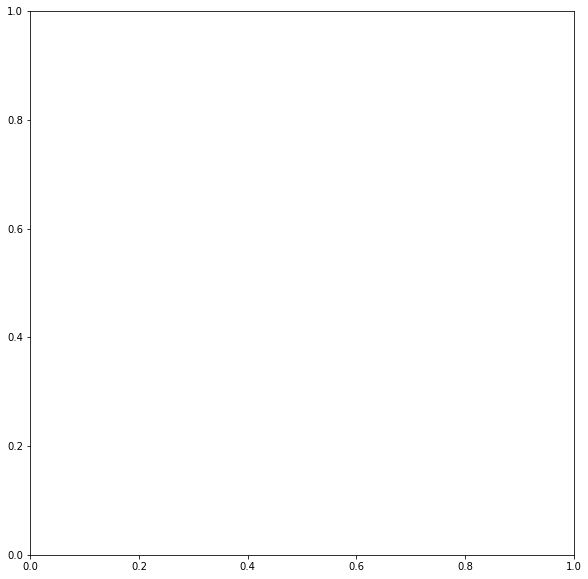

In [16]:
fig, ax = plt.subplots(figsize=(10,10))
h3_el_10.plot(column='classes',ax=ax)
ax.set_title('h3 elevation')
plt.tight_layout()

In [30]:
h3_elev = calculate_raster_diff_df([h3_el_11,h3_el_10,h3_el_9,h3_el_8,h3_el_7],raster_areas,intervals,'h3')

In [163]:
h3_elev.groupby('res').agg(diff=('difference_h3','mean'))

,diff
res,
1,3.018642
2,10.466270
3,12.121026
4,28.584829
5,52.472573


### s2

#### Injest corine vector at resolution 11, consequently downsample to resolution 13

In [164]:
s2_el_18 = raster_to_s2(os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m.tif", 'elevation', 15, 19, [26.521263, 58.283163, 26.900083, 58.505180], 3)
s2_el_18 = create_s2_geometry(s2_el_18)
s2_el_18 = s2_el_18.to_crs('EPSG:3301')
s2_el_18['area_s2_from_geom'] = s2_el_18['geometry'].area/10000

Raster pixel size 92.6624388709314
244.0187207510499
122.01115172745372
61.006023641009484
30.50351682108269
18
Start filling raster extent with s2 indexes at resolution 18
Start getting raster values for s2 cells at resolution 18


In [165]:
s2_el_17 = cell_s2_downsampling(s2_el_18,'cell_id','elevation', 17, 'numeric')
s2_el_17 = create_s2_geometry(s2_el_17)
s2_el_17 = s2_el_17.to_crs('EPSG:3301')
s2_el_17['area_s2_from_geom'] = s2_el_17['geometry'].area/10000

In [166]:
s2_el_16 = cell_s2_downsampling(s2_el_18,'cell_id','elevation', 16, 'numeric')
s2_el_16 = create_s2_geometry(s2_el_16)
s2_el_16 = s2_el_16.to_crs('EPSG:3301')
s2_el_16['area_s2_from_geom'] = s2_el_16['geometry'].area/10000

In [167]:
s2_el_15 = cell_s2_downsampling(s2_el_18,'cell_id','elevation', 15, 'numeric')
s2_el_15 = create_s2_geometry(s2_el_15)
s2_el_15 = s2_el_15.to_crs('EPSG:3301')
s2_el_15['area_s2_from_geom'] = s2_el_15['geometry'].area/10000

In [168]:
s2_el_14 = cell_s2_downsampling(s2_el_18,'cell_id','elevation', 14, 'numeric')
s2_el_14 = create_s2_geometry(s2_el_14)
s2_el_14 = s2_el_14.to_crs('EPSG:3301')
s2_el_14['area_s2_from_geom'] = s2_el_14['geometry'].area/10000

In [17]:
with open(r'D:/UTCloud/DGGS/grids/tartu_series/s2_elev.pkl','rb') as f:
    s2_elev = pickle.load(f)

In [31]:
s2_elev = calculate_raster_diff_df(s2_elev,raster_areas,intervals,'s2')

In [429]:
fig, ax = plt.subplots(figsize=(10,10))
s2_el_16.plot(column='classes',ax=ax)
ax.set_title('h3 elevation')
plt.tight_layout()

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous …

In [173]:
s2_elev.groupby('res').agg(diff=('difference_s2','mean'))

,diff
res,
1,8.179894
2,11.070702
3,17.495746
4,14.012932
5,22.691999


### rHEALPIx 

In [175]:
from rasterstats import zonal_stats

In [26]:
def raster_to_rhealpix(res,extent,raster,column):
    dfs = []
    rs = rasterio.open(raster)
    band = rs.read(1)
    for r in res:
        if len(dfs)==0:        
            df = get_rhpix_cells(r,extent)
            df = create_rhpix_geometry(df)

            df[column] = df['geometry'].apply(lambda x: band[rs.index(x.centroid.x, x.centroid.y)])
            df['poly_geom'] = df['geometry']
            df['geometry'] = df['geometry'].centroid
            init_inject = df[['geometry',column]].copy()
            df['geometry'] = df['poly_geom']
        else:
            df = get_rhpix_cells(r,extent)
            df = create_rhpix_geometry(df)
            df = gpd.sjoin(df, init_inject).reset_index()
            
            df = df.groupby(['index', column]).agg(count=(column, 'count'),geometry=('geometry','first')).reset_index().sort_values(
            by=['index', column, 'count']).groupby('index', as_index=False, sort=False).first().rename(columns={'index':'cell_id'})
            
        dfs.append(gpd.GeoDataFrame(df[['cell_id','geometry',column]]).set_crs('EPSG:4326'))
    
    return dfs

In [34]:
dfs_rheal = raster_to_rhealpix([11,10,9,8,7],[26.521263, 58.283163, 26.900083, 58.505180],os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m.tif",'elevation')

C:\Users\Iam\Anaconda3\envs\dggs\lib\site-packages\ipykernel_launcher.py:12: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  if sys.path[0] == '':


In [3]:
with open(r'D:/UTCloud/DGGS/grids/tartu_series/rHpix_elev.pkl','rb') as f:
    dfs_rheal = pickle.load(f)

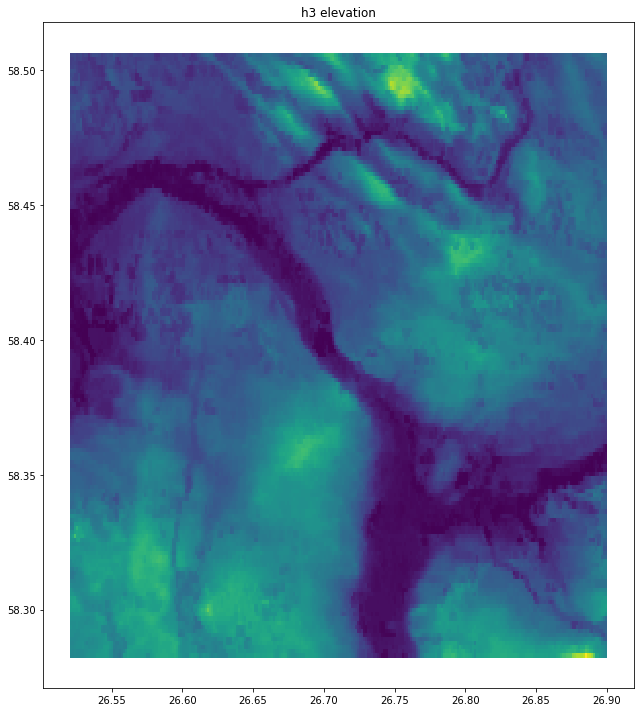

In [4]:
fig, ax = plt.subplots(figsize=(10,10))
dfs_rheal[1].plot(column='elevation',ax=ax)
ax.set_title('h3 elevation')
plt.tight_layout()

In [32]:
rheal_elev = calculate_raster_diff_df(dfs_rheal,raster_areas,intervals,'rpix')

## DGGRID

In [49]:
def raster_to_DGGRID(res,extent,raster,column,dggrid,dggrid_dggs):
    dfs = []
    extent = shape(box(extent[0],extent[1],extent[2],extent[3]))
    rs = rasterio.open(raster)
    band = rs.read(1)
    for r in res:
        if len(dfs)==0:        
            df = dggrid.grid_cell_polygons_for_extent(dggrid_dggs, r, clip_geom=extent).rename(columns={'Name':'cell_id'})
            
            df[column] = df['geometry'].apply(lambda x: band[rs.index(x.centroid.x, x.centroid.y)])
            df['poly_geom'] = df['geometry']
            df['geometry'] = df['geometry'].centroid
            init_inject = df[['geometry',column]].copy()
            df['geometry'] = df['poly_geom']
        else:
            
            df = dggrid.grid_cell_polygons_for_extent(dggrid_dggs, r, clip_geom=extent).rename(columns={'Name':'cell_id'})
            df = gpd.sjoin(df, init_inject).reset_index()
            df = df.groupby(['index', column]).agg(count=(column, 'count'),geometry=('geometry','first')).reset_index().sort_values(
            by=['index', column, 'count']).groupby('index', as_index=False, sort=False).first().rename(columns={'index':'cell_id'})
            
        dfs.append(gpd.GeoDataFrame(df[['cell_id','geometry',column]]).set_crs('EPSG:4326'))
    
    return dfs

In [50]:
dfs_3H = raster_to_DGGRID([21,20,19,18,17],[26.521263, 58.283163, 26.900083, 58.505180],os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m.tif",'elevation',dggrid,'ISEA3H')

** executing DGGRID version 7.07 **
type sizes: big int: 64 bits / big double: 128 bits

** loading meta file metafile_534d2c55-0945-413f-a9f1-83ed09524db7...
* using parameter values:
dggrid_operation GENERATE_GRID (user set)
dggs_type ISEA3H (user set)
dggs_topology HEXAGON (user set)
dggs_proj ISEA (user set)
dggs_aperture_type PURE (user set)
dggs_aperture 3 (user set)
proj_datum WGS84_AUTHALIC_SPHERE (default)
dggs_orient_specify_type SPECIFIED (user set)
dggs_num_placements 1 (user set)
dggs_orient_output_file_name grid.meta (default)
dggs_vert0_lon 11.25 (user set)
dggs_vert0_lat 58.2825 (user set)
dggs_vert0_azimuth 0 (user set)
dggs_res_specify_type SPECIFIED (user set)
dggs_res_spec 21 (user set)
rng_type RAND (default)
geodetic_densify 0 (default)
clip_subset_type GDAL (user set)
clip_region_files /mnt/d/UTCloud/DGGS/working/Python/PyProj/cell_stats/dggrid_workdir/temp_clip_8cac9417-7690-4360-b699-e61f92fdb53b.geojson (user set)
clip_type POLY_INTERSECT (default)
clipper_sca

In [52]:
dfs_4T = raster_to_DGGRID([16,15,14,13,12],[26.521263, 58.283163, 26.900083, 58.505180],os.path.dirname(os.getcwd()) + r"/data/eesti_clipped/small_extent/MeritDEM90m.tif",'elevation',dggrid,'ISEA4T')

** executing DGGRID version 7.07 **
type sizes: big int: 64 bits / big double: 128 bits

** loading meta file metafile_cd6b91ea-041b-44bd-b00d-b26d7707d245...
* using parameter values:
dggrid_operation GENERATE_GRID (user set)
dggs_type ISEA4T (user set)
dggs_topology TRIANGLE (user set)
dggs_proj ISEA (user set)
dggs_aperture_type PURE (user set)
dggs_aperture 4 (user set)
proj_datum WGS84_AUTHALIC_SPHERE (default)
dggs_orient_specify_type SPECIFIED (user set)
dggs_num_placements 1 (user set)
dggs_orient_output_file_name grid.meta (default)
dggs_vert0_lon 11.25 (user set)
dggs_vert0_lat 58.2825 (user set)
dggs_vert0_azimuth 0 (user set)
dggs_res_specify_type SPECIFIED (user set)
dggs_res_spec 16 (user set)
rng_type RAND (default)
geodetic_densify 0 (default)
clip_subset_type GDAL (user set)
clip_region_files /mnt/d/UTCloud/DGGS/working/Python/PyProj/cell_stats/dggrid_workdir/temp_clip_9e97f38b-4c8d-499b-a596-feaa5dfb7397.geojson (user set)
clip_type POLY_INTERSECT (default)
clipper_sc

In [33]:
with open(r'd:\UTCloud\DGGS\grids\tartu_series\ISEA3H_elev.pkl','rb') as f:
    dfs_3H = pickle.load(f)

In [34]:
with open(r'd:\UTCloud\DGGS\grids\tartu_series\ISEA4T_elev.pkl','rb') as f:
    dfs_4T = pickle.load(f)

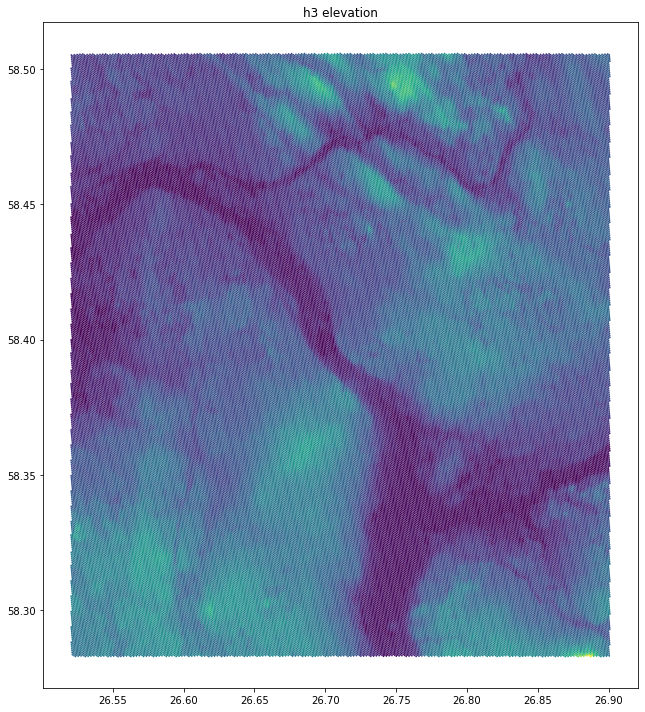

In [57]:
fig, ax = plt.subplots(figsize=(10,10))
dfs_3H[0].plot(column='elevation',ax=ax)
ax.set_title('h3 elevation')
plt.tight_layout()

In [35]:
isea3H_elev = calculate_raster_diff_df(dfs_3H,raster_areas,intervals,'ISEA3H')

In [36]:
isea4T_elev = calculate_raster_diff_df(dfs_4T,raster_areas,intervals,'ISEA4T')

## Compare results

In [37]:
elevation_results = pd.concat([h3_elev,s2_elev,rheal_elev,isea3H_elev,isea4T_elev],axis=1)

In [43]:
elevation_results.to_csv(r'd:\UTCloud\DGGS\results\downsampling_loss\elevation.csv')

In [3]:
elevation_results = pd.read_csv(r'd:\UTCloud\DGGS\results\downsampling_loss\elevation.csv')

In [40]:
elevation_results = elevation_results.loc[:,~elevation_results.columns.duplicated()]

In [210]:
elevation_results[~((elevation_results['classes']==9)&(elevation_results['res']==1))]

,classes,cells_cnt,area_h3,intervals,area_original_from_raster,difference_h3,res,area_s2,difference_s2,area_rpix,difference_rpix,area_ISEA3H,difference_ISEA3H,area_ISEA4T,difference_ISEA4T
0,0,41169.0,7079.108451,"[ 29.66, 37.08]",7059.569898,0.276767,1,7140.849703,1.151342,2510.948012,64.431997,6219.771049,11.895893,6484.819245,8.141440
1,1,52357.0,9002.911929,"( 37.08, 44.50]",9009.780059,0.076230,1,9053.320526,0.483258,3199.052839,64.493552,7877.396398,12.568383,8176.900474,9.244172
2,2,65646.0,11287.987403,"( 44.50, 51.92]",11291.653205,0.032465,1,11383.371444,0.812266,4011.668812,64.472263,9939.870518,11.971521,10336.318424,8.460540
3,3,65526.0,11267.353115,"( 51.92, 59.34]",11263.020429,0.038468,1,11355.762843,0.823424,4003.153856,64.457546,9891.837613,12.174202,10246.193463,9.028013
4,4,51468.0,8850.046243,"( 59.34, 66.76]",8870.195278,0.227154,1,8928.650435,0.659006,3146.517168,64.527081,7797.014802,12.098724,8158.397998,8.024595
5,5,31229.0,5369.901572,"( 66.76, 74.19]",5344.784781,0.469931,1,5427.678472,1.550927,1895.139980,64.542258,4681.247698,12.414664,4836.308361,9.513506
6,6,9103.0,1565.282718,"( 74.19, 81.61]",1556.907174,0.537960,1,1586.488014,1.899975,553.472129,64.450538,1366.977262,12.199180,1445.580507,7.150501
7,7,979.0,168.341402,"( 81.61, 89.03]",166.626847,1.028979,1,168.527504,1.140667,59.444031,64.325058,147.039505,11.755214,144.438680,13.316082
8,8,339.0,58.291864,"( 89.03, 96.45]",56.072519,3.957991,1,59.099662,5.398622,20.564422,63.325312,50.973695,9.093267,53.120010,5.265518
0,0,5942.0,7185.793163,"[ 29.66, 37.08]",7059.569898,1.787974,2,7189.763953,1.844221,7951.167777,12.629635,7882.787697,11.661019,8258.050901,16.976686


In [5]:
elevation_results_grouped = elevation_results.groupby('res').mean()[['difference_h3','difference_s2','difference_rpix','difference_ISEA3H','difference_ISEA4T']].reset_index()

In [26]:
elevation_results_grouped

,res,difference_h3,difference_s2,difference_rpix,difference_ISEA3H,difference_ISEA4T
0,1,3.037036,8.179894,12.167274,10.616047,12.411286
1,2,10.466270,11.070702,16.903644,15.642965,14.201974
2,3,12.121026,17.495746,46.766979,20.935179,40.817475
3,4,28.584829,14.012932,72.566568,43.473872,60.200350
4,5,52.472573,22.691999,112.639971,57.451130,76.965270


In [6]:
elevation_results_grouped.columns = ['resolution','H3','S2','rHEALPix','ISEA3H','EAGGR']

In [42]:
elevation_results.groupby('res').mean()

,classes,cells_cnt,area_h3,area_original_from_raster,difference_h3,area_s2,difference_s2,area_rpix,difference_rpix,area_ISEA3H,difference_ISEA3H,area_ISEA4T,difference_ISEA4T
res,,,,,,,,,,,,,
1,4.5,31785.6,5467.768980,5462.417768,3.037036,5511.309527,8.179894,5523.957099,12.167274,5513.197215,10.616047,5525.495731,12.411286
2,4.5,4573.6,5530.956515,5462.417768,10.466270,5535.543063,11.070702,5568.853897,16.903644,5528.538380,15.642965,5576.273585,14.201974
3,4.5,666.1,5638.707132,5462.417768,12.121026,5583.879016,17.495746,5725.881869,46.766979,5585.001563,20.935179,5674.366532,40.817475
4,4.5,100.1,5931.604992,5462.417768,28.584829,5681.932446,14.012932,6325.072829,72.566568,5671.902043,43.473872,5871.027356,60.200350
5,4.5,16.1,6677.792725,5462.417768,52.472573,5875.282718,22.691999,6955.679307,112.639971,5812.177740,57.451130,6340.731210,76.965270


NameError: name 'corine_results_grouped' is not defined

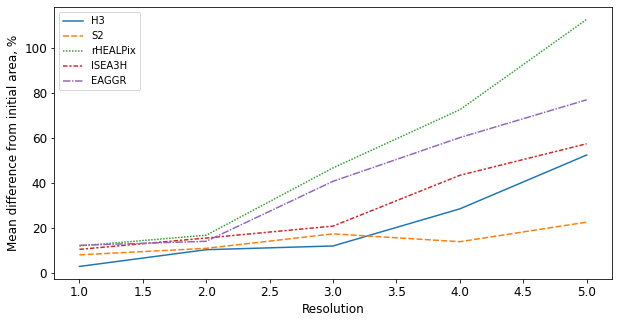

In [7]:
fig, ax = plt.subplots(figsize=(10,5))
sns.lineplot(data=elevation_results_grouped.set_index('resolution'),ax=ax)
ax.tick_params(axis='both', which='major', labelsize=12)
ax.set_xlabel('Resolution', fontsize=12)
ax.set_ylabel('Mean difference from initial area, %', fontsize=12)
ax.set_xticks(corine_results_grouped['resolution'])
plt.tight_layout()